In [ ]:
#!pip install cmake
#!pip install dlib

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import dlib
import cv2
import matplotlib.pyplot as plt
import sys
import os
import glob
import numpy as np
from google.colab.patches import cv2_imshow
import seaborn as sns


In [ ]:
def load_images(path):
    img = cv2.imread(path)
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Landmark Detection

## Testing on a Single Image

In [ ]:
def shape_to_np(shape, dtype="int"):
	# initialize the list of (x, y)-coordinates
	coords = np.zeros((68, 2), dtype=dtype)
	# loop over the 68 facial landmarks and convert them
	# to a 2-tuple of (x, y)-coordinates
	for i in range(0, 68):
		coords[i] = (shape.part(i).x, shape.part(i).y)
	# return the list of (x, y)-coordinates
	return coords

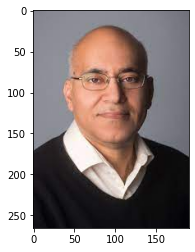

In [ ]:
malik_path = '/content/drive/MyDrive/DeepFakeDetection/data/Malik.jpeg'
malik = load_images(malik_path)
plt.imshow(malik)

In [ ]:
predictor_path = '/content/drive/MyDrive/DeepFakeDetection/model/shape_predictor_68_face_landmarks.dat'
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor(predictor_path)

In [ ]:
malik = cv2.cvtColor(malik, cv2.COLOR_BGR2GRAY)
dets = detector(malik)

In [ ]:
#predictor(gray, rect)
landmarks = predictor(malik, dets[0])
landmarks = shape_to_np(landmarks)

In [ ]:
	for (x, y) in landmarks:
		cv2.circle(malik, (x, y), 1, (0, 0, 255), -1)

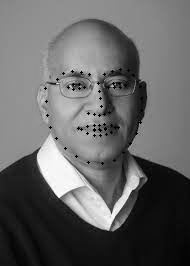

In [ ]:
cv2_imshow(malik)

# Testing on Video

In [ ]:
def shape_to_np(shape, dtype="int"):
	# initialize the list of (x, y)-coordinates
	coords = np.zeros((68, 2), dtype=dtype)
	# loop over the 68 facial landmarks and convert them
	# to a 2-tuple of (x, y)-coordinates
	for i in range(0, 68):
		coords[i] = (shape.part(i).x, shape.part(i).y)
	# return the list of (x, y)-coordinates
	return coords

In [ ]:
def generate_landmarks(frame, detector, predictor):

  #for a given frame, return the landmarks

  frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
  dets = detector(frame)

  landmarks = predictor(frame, dets[0])
  landmarks = shape_to_np(landmarks)

  return landmarks


In [ ]:
video_path = '/content/drive/MyDrive/DeepFakeDetection/data/FakeAVCeleb_v1.2/RealVideo-RealAudio/African/men/id00076/00109.mp4'

def add_landmarks(cv2_cap, detector, predictor):

  #cap = cv2.VideoCapture(video_path)

  dlib_frames = []
  video_landmarks = []

  # Read until video is completed
  while(cv2_cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cv2_cap.read()
    if ret == True:

      #get landmarks
      landmarks = generate_landmarks(frame, detector, predictor)
      video_landmarks.append(landmarks)

      #overlay landmarks onto image
      for idx, (x, y) in enumerate(landmarks):
        cv2.circle(frame, (x, y), 1, (0, 0, 255), -1)
        #cv2.putText(frame, str(idx), (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.1,(255,255,255),2,cv2.LINE_AA)
      
      dlib_frames.append(frame)
  
    # Break the loop
    else: 
      break

  return dlib_frames, video_landmarks
  







  

In [ ]:
def show_video(video_path, detector, predictor):
    cap = cv2.VideoCapture(video_path)

    dlib_frames, video_landmarks = add_landmarks(cap, detector, predictor)

    for frame in dlib_frames:
      cv2_imshow(frame)


      if cv2.waitKey(25) & 0xFF == ord('q'):
        break

    cap.release()
    cv2.destroyAllWindows()

    #dlib_frames is the frame with the landmarks added
    #video_landmark is a list of landmarks objects of length the number of frames
    return dlib_frames, video_landmarks



    

In [ ]:
video_path = '/content/drive/MyDrive/DeepFakeDetection/data/FakeAVCeleb_v1.2/RealVideo-RealAudio/African/men/id00076/00109.mp4'
predictor_path = '/content/drive/MyDrive/DeepFakeDetection/model/shape_predictor_68_face_landmarks.dat'
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor(predictor_path)

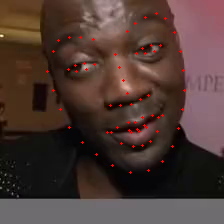

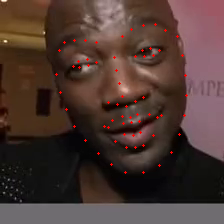

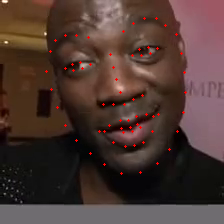

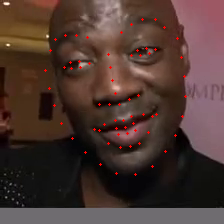

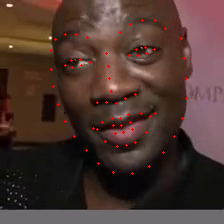

...

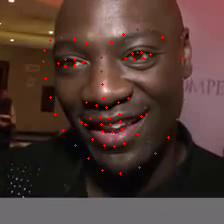

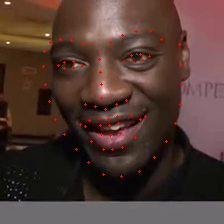

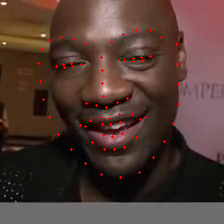

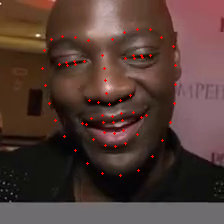

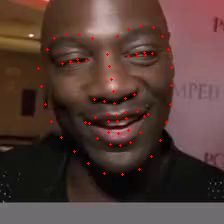

In [ ]:
dlib_frames, video_landmarks = show_video(video_path, detector, predictor)

In [ ]:
def calc_distance(coord_1, coord_2):
  return np.sqrt((coord_1[0] - coord_2[0])**2 + (coord_1[1] - coord_2[1])**2)


In [ ]:
lip_distance = []
top_lip_idx = 62
bottom_lip_idx = 66

lip_distance = []
for landmark in video_landmarks:
  lip_distance.append(calc_distance(landmark[top_lip_idx], landmark[bottom_lip_idx]))

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


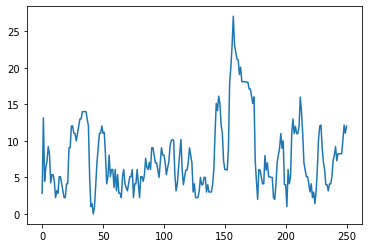

In [ ]:
x = np.arange(0, len(dlib_frames), 1)
sns.lineplot(x, lip_distance)

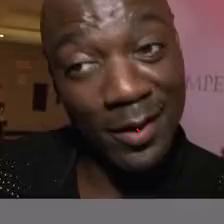

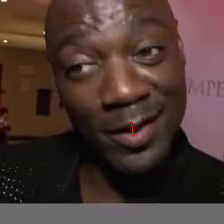

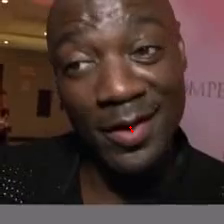

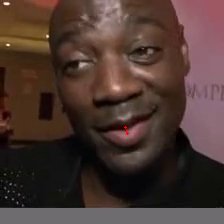

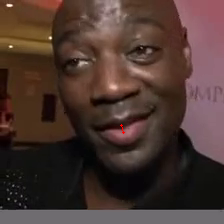

...

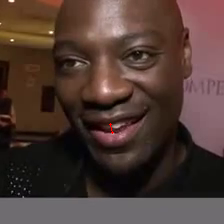

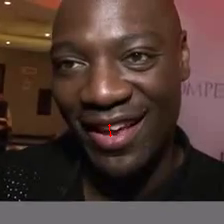

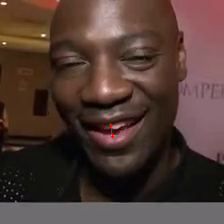

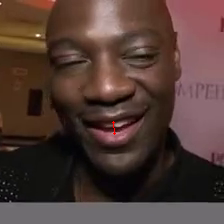

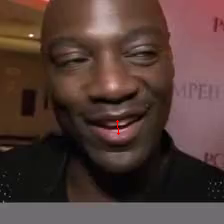

In [ ]:
cap = cv2.VideoCapture(video_path)
idx = 0
clean_frames = []

while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:
    #add landmarks to frame
    cv2.circle(frame, video_landmarks[idx][top_lip_idx], 1, (0, 0, 255), -1)
    cv2.circle(frame, video_landmarks[idx][bottom_lip_idx], 1, (0, 0, 255), -1)
    cv2.line(frame, video_landmarks[idx][top_lip_idx], video_landmarks[idx][bottom_lip_idx], (0, 0, 255))

    cv2_imshow(frame)
    clean_frames.append(frame)
    idx += 1


    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  else: 
    break






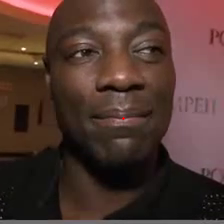

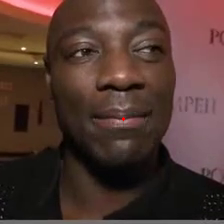

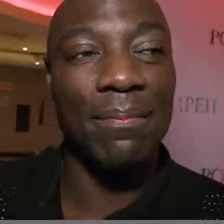

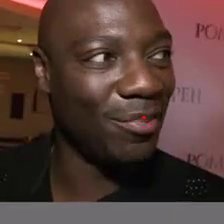

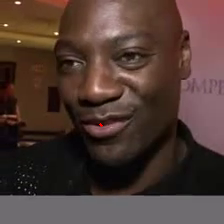

...

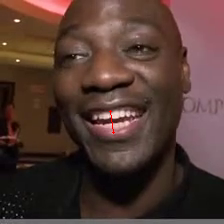

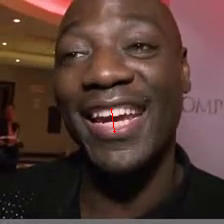

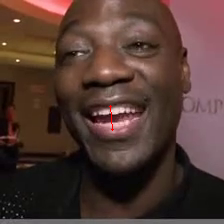

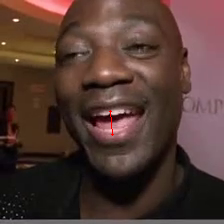

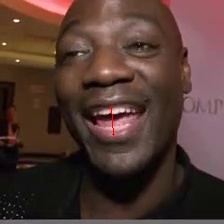

In [ ]:
sort_idx = np.argsort(lip_distance)
for idx in sort_idx:
  cv2_imshow(clean_frames[idx])



In [ ]:
print('This is a test')